Text(0.5, 0, 'p(x,t)')

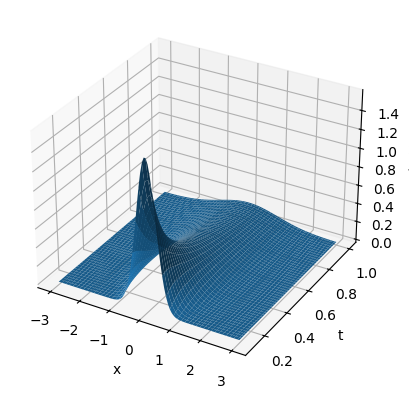

In [25]:
import numpy as np
%matplotlib inline
pi = np.pi
def p(x,t):
    '''
    Geometric Brownian motion density function
    '''
    return np.exp(-x**2/(2*t))/(2*pi*t)


# make a grid of x,y and t values
x = np.linspace(-3,3,100)

t = np.linspace(0.1,1,100)
X,T = np.meshgrid(x,t)

# calculate the density function
Z = p(X,T)

# plot the density function
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, T, Z)
ax.set_xlabel('x')
ax.set_ylabel('t')
ax.set_zlabel('p(x,t)')



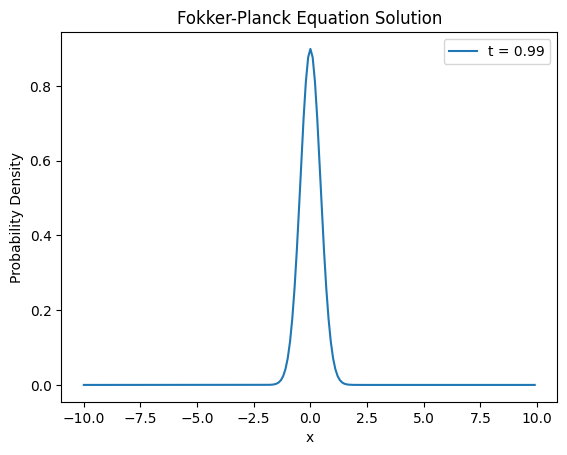

In [5]:
import numpy as np
import matplotlib.pyplot as plt

'''
It sets up the parameters for the simulation, including the diffusion coefficient, spatial step size, and time step size.
It initializes the spatial grid (x) and the time grid (t), as well as the initial condition for the probability density function p. The initial condition is chosen to be a delta function centered at x=0, which is represented numerically by setting the central value of p to 1/dx (to approximate the integral of the delta function over a small interval to be 1).
It then iteratively solves the Fokker-Planck equation using a simple finite difference scheme for the diffusion term. This loop updates the probability density p at each time step based on the diffusion process.
'''


# Parameters
D = 0.1  # Diffusion coefficient
dx = 0.1  # Space step
dt = 0.01  # Time step
x = np.arange(-10, 10, dx)  # Space grid
t = np.arange(0, 1, dt)  # Time grid

# Initial condition (delta function at x=0)
p = np.zeros(x.shape)
p[int(len(x) / 2)] = 1 / dx
ps = []

# Diffusion (Fokker-Planck) solver
for n in range(1, len(t)):
    p_new = np.zeros(x.shape)
    for i in range(1, len(x)-1):
        p_new[i] = p[i] + (D * dt / dx**2) * (p[i+1] - 2*p[i] + p[i-1])
    p = p_new
    ps.append(p)

ps = np.array(ps)
# Plotting the result
plt.plot(x, p, label=f't = {t[-1]}')
plt.xlabel('x')
plt.ylabel('Probability Density')
plt.title('Fokker-Planck Equation Solution')
plt.legend()
plt.show()


In [ ]:
# animate time slices of the density p(x,t)
import matplotlib.animation as animation
from IPython.display import HTML

%matplotlib notebook
fig = plt.figure()
ax = fig.add_subplot(111)
line, = ax.plot(x, ps[0,:])
# ax.set_xlim(-3,3)
# ax.set_ylim(0,Z.max())
def animate(i):
    line.set_ydata(ps[i,:])
    return line,

anim = animation.FuncAnimation(fig, animate, np.arange(1, len(ps)), interval=25, blit=True)
HTML(anim.to_jshtml())

In [14]:
import numpy as np
import matplotlib.pyplot as plt

# Parameters
D = 0.1  # Diffusion coefficient
k = 0.1  # Drift coefficient
dx = 0.1  # Space step
dt = 0.01  # Time step
x = np.arange(-10, 10, dx)  # Space grid
t = np.arange(0, 5, dt)  # Time grid
N = len(x)

# Initial condition (delta function at x=0)
p = np.zeros(x.shape)
p[int(N / 2)] = 1 / dx
ps = []
# Diffusion (Fokker-Planck) solver with drift term
for n in range(1, len(t)):
    p_new = np.zeros(x.shape)
    for i in range(1, len(x)-1):
        # Drift term
        F = -k * x[i]
        
        # Central difference for drift term, forward time, centered space (FTCS) for diffusion term
        drift_term = - (F * (p[i+1] - p[i-1]) / (2 * dx))
        diffusion_term = D * (p[i+1] - 2*p[i] + p[i-1]) / dx**2
        
        p_new[i] = p[i] + dt * (drift_term + diffusion_term)
        
    # Update the probability distribution
    p = p_new
    ps.append(p)

# Plotting the result
plt.plot(x, p, label=f't = {t[-1]}')
plt.xlabel('x')
plt.ylabel('Probability Density')
plt.title('Fokker-Planck Equation Solution with Drift')
plt.legend()
plt.show()


<IPython.core.display.Javascript object>

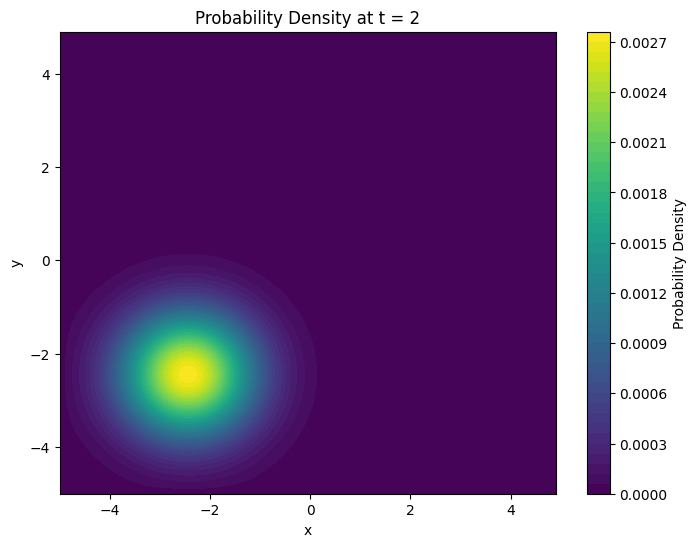

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline 
# Parameters
D = 0.1  # Diffusion coefficient
k = 0.1  # Strength of the harmonic potential
dx = dy = 0.1  # Space step for x and y
dt = 0.01  # Time step
x = np.arange(-5, 5, dx)  # x grid
y = np.arange(-5, 5, dy)  # y grid
X, Y = np.meshgrid(x, y)  # 2D grid for x and y
t_end = 2  # End time
t = np.arange(0, t_end, dt)  # Time array

# Initial condition: a Gaussian away from the center
sigma = 0.5  # Width of the Gaussian
x0, y0 = -2, -2  # Initial displacement
p = np.exp(-((X - x0)**2 + (Y - y0)**2) / (2 * sigma**2))
p /= np.sum(p)  # Normalize the initial condition
ps = []
# Solver loop
Nt = len(t)
Nx, Ny = len(x), len(y)
for n in range(1, Nt):
    p_new = np.copy(p)
    for i in range(1, Nx-1):
        for j in range(1, Ny-1):
            # Diffusion terms
            diffusion_x = D * (p[i+1, j] - 2*p[i, j] + p[i-1, j]) / dx**2
            diffusion_y = D * (p[i, j+1] - 2*p[i, j] + p[i, j-1]) / dy**2
            
            # Drift terms
            drift_x = k * (x[i] * (p[i+1, j] - p[i-1, j]) / (2 * dx))
            drift_y = k * (y[j] * (p[i, j+1] - p[i, j-1]) / (2 * dy))
            
            # Update p
            p_new[i, j] = p[i, j] + dt * (diffusion_x + diffusion_y - drift_x - drift_y)
            
    p = p_new
    ps.append(p)

# Plotting the result
plt.figure(figsize=(8, 6))
plt.contourf(X, Y, p, levels=50, cmap='viridis')
plt.colorbar(label='Probability Density')
plt.xlabel('x')
plt.ylabel('y')
plt.title(f'Probability Density at t = {t_end}')
plt.show()


In [22]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML

%matplotlib notebook


# Constants and parameters
k = 1.0  # Spring constant for the harmonic potential
D = 0.1  # Diffusion coefficient
dx = 0.5  # Space step in x and y
dt = 0.01  # Time step
x = np.arange(-10, 10, dx)
y = np.arange(-10, 10, dx)
X, Y = np.meshgrid(x, y)
t_steps = 100  # Number of time steps for the animation

# Initial condition: Gaussian distribution away from the center
x0, y0 = 4, 4  # Initial displacement
sigma = 1.0  # Width of the initial Gaussian distribution
p = np.exp(-((X-x0)**2 + (Y-y0)**2) / (2*sigma**2))
p /= np.sum(p)  # Normalize the initial condition

# Prepare the figure for animation
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim([x.min(), x.max()])
ax.set_ylim([y.min(), y.max()])
z_max = np.max(p) * 1.1  # Slightly higher than the initial max to account for spread
ax.set_zlim([0, z_max])
ax.view_init(30, -45)  # Isometric view

def update(frame):
    global p
    ax.clear()
    ax.set_zlim([0, .05])
    # Only update the surface plot, not the axis limits
    ax.plot_surface(X, Y, p, cmap='viridis')
    ax.set_title(f'Time = {frame * dt:.2f}s')
    
    # Update p using the Fokker-Planck equation
    for i in range(1, len(x)-1):
        for j in range(1, len(y)-1):
            Fx = -k * x[i]
            Fy = -k * y[j]
            drift_x = -Fx * (p[j, i+1] - p[j, i-1]) / (2 * dx)
            drift_y = -Fy * (p[j+1, i] - p[j-1, i]) / (2 * dx)
            diffusion = D * ((p[j, i+1] - 2*p[j, i] + p[j, i-1]) + (p[j+1, i] - 2*p[j, i] + p[j-1, i])) / dx**2
            p[j, i] += dt * (diffusion + drift_x + drift_y)
    

# Create animation
anim = FuncAnimation(fig, update, frames=t_steps, repeat=False, interval=25, blit=True)
HTML(anim.to_jshtml())


<IPython.core.display.Javascript object>

In [15]:
# animate time slices of the density p(x,t)
import matplotlib.animation as animation
from IPython.display import HTML

%matplotlib notebook

ps = np.array(ps)

fig = plt.figure()
ax = fig.add_subplot(111)
line, = ax.plot(x, ps[0,:])
# ax.set_xlim(-3,3)
# ax.set_ylim(0,Z.max())
def animate(i):
    line.set_ydata(ps[i,:])
    return line,

anim = animation.FuncAnimation(fig, animate, np.arange(1, len(ps)), interval=25, blit=True)
HTML(anim.to_jshtml())

<IPython.core.display.Javascript object>

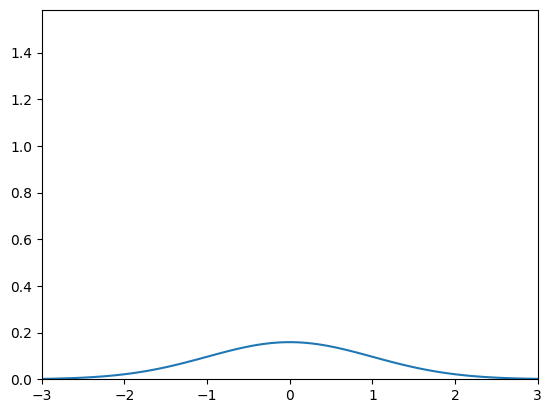

In [26]:
# animate time slices of the density p(x,t)
import matplotlib.animation as animation
fig = plt.figure()
ax = fig.add_subplot(111)
line, = ax.plot(x, Z[0,:])
ax.set_xlim(-3,3)
ax.set_ylim(0,Z.max())
def animate(i):
    line.set_ydata(Z[i,:])
    return line,

anim = animation.FuncAnimation(fig, animate, np.arange(1, 100), interval=25, blit=True)
HTML(anim.to_jshtml())


In [1]:
import numpy as np
from fplanck import fokker_planck, boundary, harmonic_potential, gaussian_pdf


nm = 1e-9
viscosity = 8e-4
radius = 50*nm
drag = 6*np.pi*viscosity*radius

U = harmonic_potential((0,0), 1e-6)

sim = fokker_planck(temperature=300, drag=drag, extent=600*nm,
            resolution=10*nm, boundary=boundary.reflecting, potential=U)

### steady-state solution
steady = sim.steady_state()

### time-evolved solution
pdf = gaussian_pdf(center=-150*nm, width=30*nm)
p0 = pdf(sim.grid[0])
Nsteps = 200
time, Pt = sim.propagate_interval(pdf, 3e-3, Nsteps=Nsteps)

In [ ]:
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.animation import FuncAnimation

from IPython.display import HTML

%matplotlib notebook

### animation
fig, ax = plt.subplots()

ax.plot(sim.grid[0]/nm, steady, color='k', ls='--', alpha=.5)
ax.plot(sim.grid[0]/nm, p0, color='red', ls='--', alpha=.3)
line, = ax.plot(sim.grid[0]/nm, p0, lw=2, color='C3')

def update(i):
    line.set_ydata(Pt[i])
    return [line]

anim = FuncAnimation(fig, update, frames=range(Nsteps), interval=30)
ax.set(xlabel='x (nm)', ylabel='normalized PDF')
ax.margins(x=0)

HTML(anim.to_jshtml())

In [2]:
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.animation import FuncAnimation

from IPython.display import HTML

%matplotlib notebook

### animation
fig, ax = plt.subplots()

ax.plot(sim.grid[0]/nm, steady, color='k', ls='--', alpha=.5)
ax.plot(sim.grid[0]/nm, p0, color='red', ls='--', alpha=.3)
line, = ax.plot(sim.grid[0]/nm, p0, lw=2, color='C3')

def update(i):
    line.set_ydata(Pt[i])
    return [line]

anim = FuncAnimation(fig, update, frames=range(Nsteps), interval=30)
ax.set(xlabel='x (nm)', ylabel='normalized PDF')
ax.margins(x=0)

HTML(anim.to_jshtml())

<IPython.core.display.Javascript object>

In [ ]:
# save animation to gif
anim.save('anim.gif', writer='imagemagick', fps=30)